# 1. Run fastdup

In [1]:
import fastdup
import os 
from IPython.display import HTML
import numpy as np

In [2]:
fastdup.run(input_dir="./Kartaview_Dataset", work_dir='Karta_out_2', 
            nearest_neighbors_k=5, turi_param='ccthreshold=0.95')

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
Going to loop over dir Kartaview_Dataset
Found total 11084 images to run on
Found total 11084 images to run on■■■■■■■■■■■■■■■■■] 100% Estimated: 0 Minutes 0 Features
3034) Finished write_index() NN model
Stored nn model index file Karta_out_2/nnf.index
Total time took 348614 ms
Found a total of 276 fully identical images (d>0.990), which are 0.42 %
Found a total of 875 nearly identical images(d>0.980), which are 1.32 %
Found a total of 26341 above threshold images (d>0.900), which are 39.61 %
Found a total of 2771 outlier images         (d<0.050), which are 4.17 %
Min distance found 0.629 max distance 0.997
1676410209 : INFO:     (add_vertices:460): Num vertices for group 0: 11084
1676410209 : INFO:     (commit_edge_buffer:609): In commit edge buffer (0,0)
1676410209 : INFO:     (commit_edge_buffer:680): Shuffling edges ...
1676410209 : INFO:     (commit_edge_buffer:688): Done shuffling edges in 0.017393 secs
16

0

# 2. Use create_similarity_gallery

In [3]:
results_dir = '/home/yiwei/Documents/New Fast Image Analysis/Karta_out_2'

In [5]:
new_similar_gallery_save_path = os.path.join(results_dir, 'new-similar-gallery')
if not os.path.exists(new_similar_gallery_save_path):
    os.makedirs(new_similar_gallery_save_path)
    
df_simi = fastdup.create_similarity_gallery('Karta_out_2', save_path=new_similar_gallery_save_path, 
                                  get_label_func=lambda x: x.split('/')[-2])

100%|███████████████████████████████████████████| 20/20 [00:00<00:00, 21.12it/s]


Stored similar images view in  /home/yiwei/Documents/New Fast Image Analysis/Karta_out_2/new-similar-gallery/topk_similarity.html


In [8]:
df_simi.to_csv(new_similar_gallery_save_path + '/df_simi.csv')

In [21]:
print(df_simi['to'][1])

['Kartaview_Dataset/Basic_set/186544_9a9b0_5919c060f21fd.jpg', 'Kartaview_Dataset/Basic_set/186544_597f0_5919bfedd104c.jpg']


# 3. Use create_components_gallery

Failed to read config file ./config.json
Rest_set


100%|███████████████████████████████████████████| 20/20 [00:09<00:00,  2.17it/s]


Finished OK. Components are stored as image files /home/yiwei/Documents/New Fast Image Analysis/Karta_out_2/components-gallery/components_[index].jpg
Stored components visual view in  /home/yiwei/Documents/New Fast Image Analysis/Karta_out_2/components-gallery/components.html
Execution time in seconds 11.6



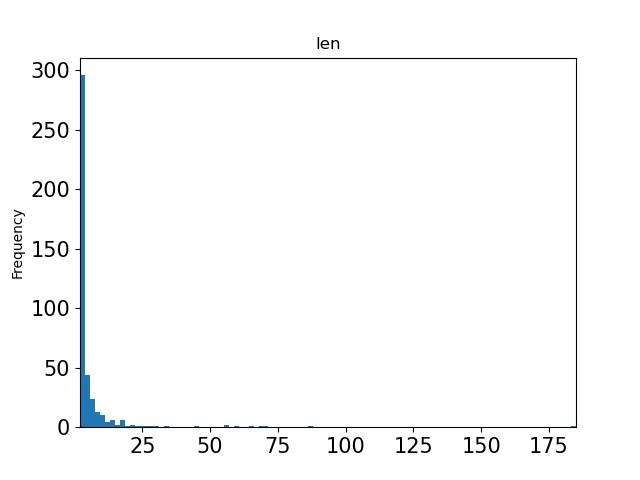
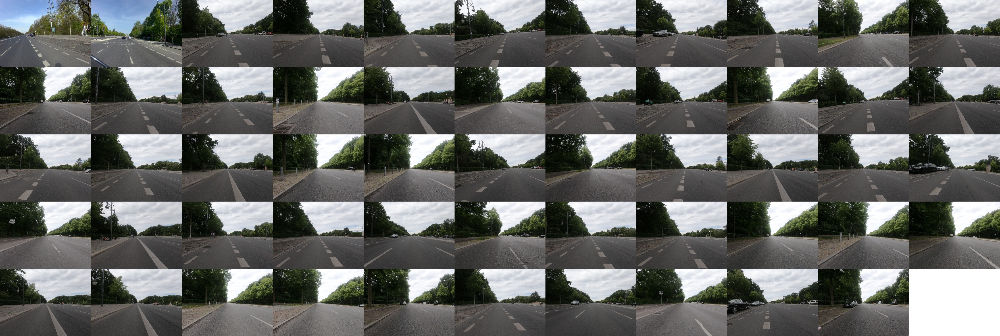
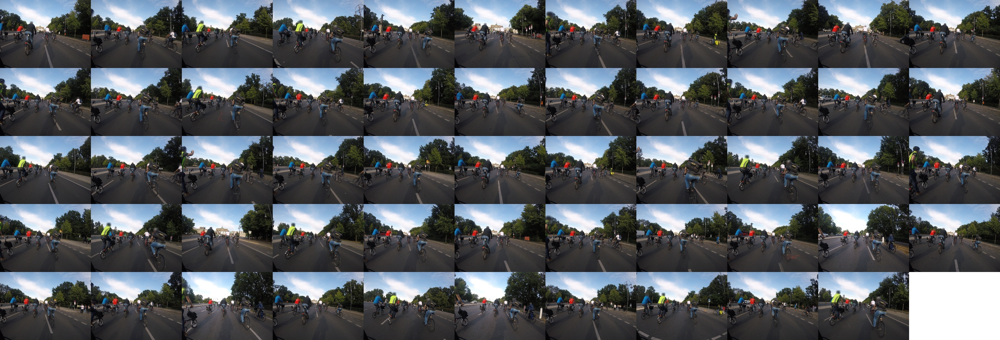
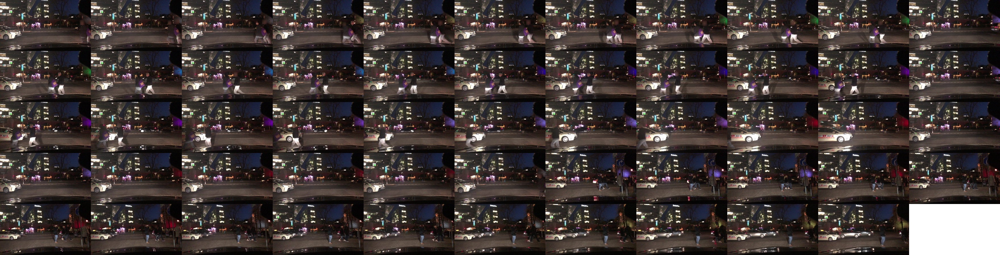
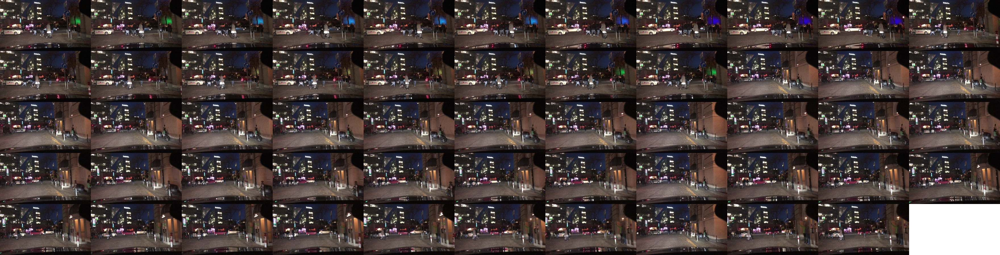
...
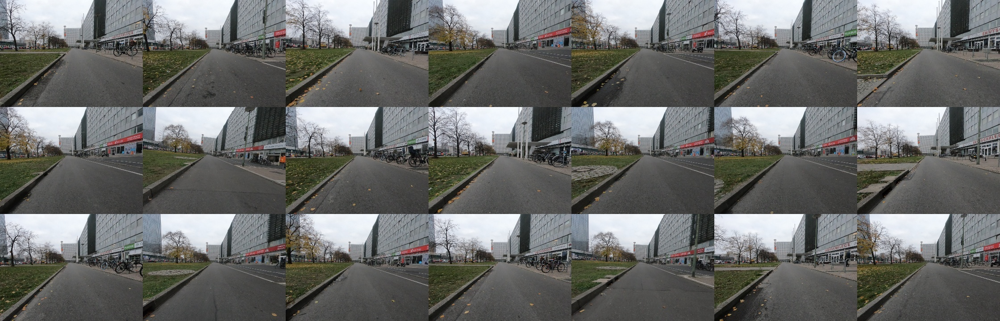
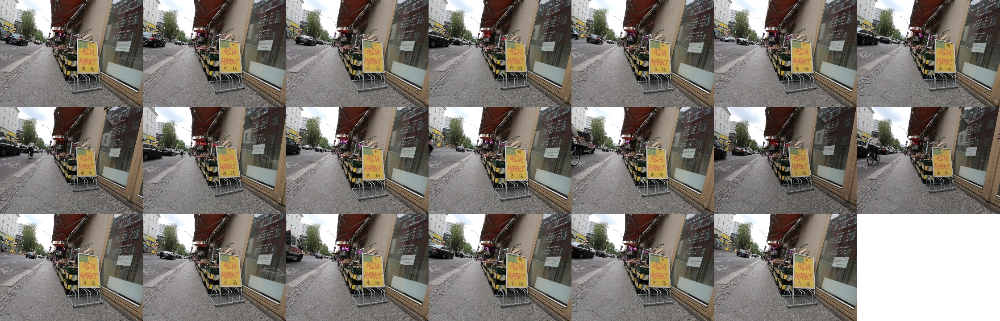
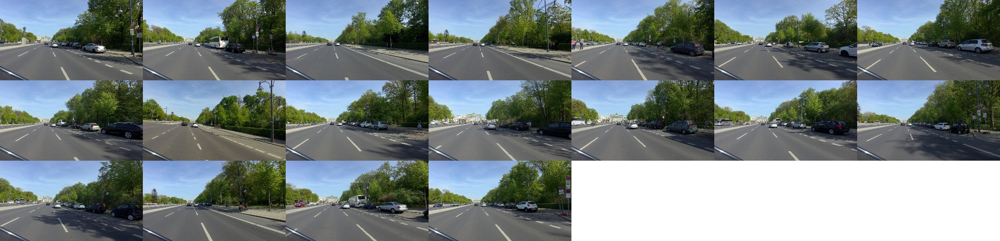
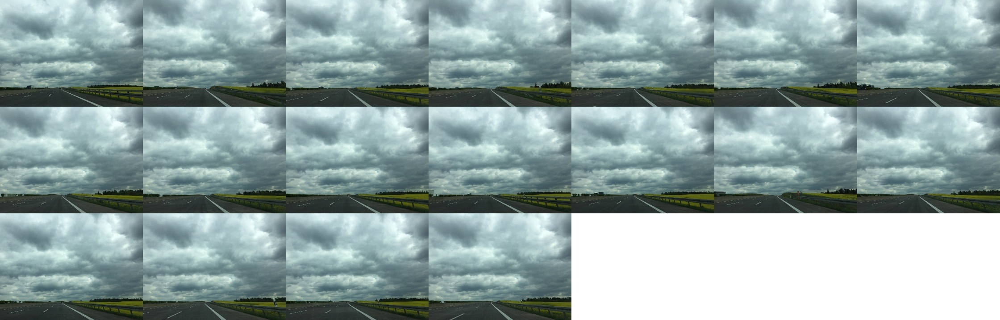

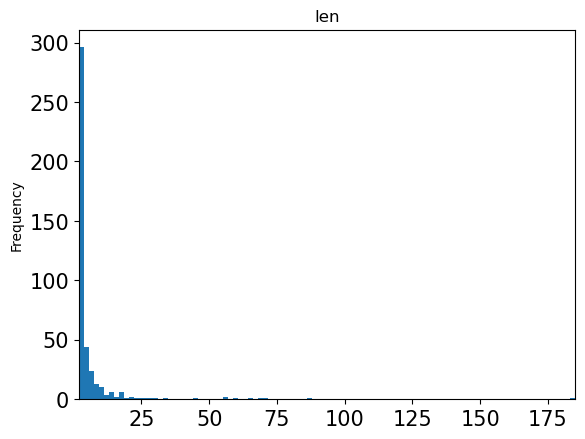

In [23]:
components_gallery_save_path = os.path.join(results_dir, 'components-gallery')
if not os.path.exists(components_gallery_save_path):
    os.makedirs(components_gallery_save_path)
    
fastdup.create_components_gallery('Karta_out_2', save_path=components_gallery_save_path, 
                                  get_label_func=lambda x: x.split('/')[-2])

gallery_file_name = os.path.join(components_gallery_save_path, 'components.html')
HTML(filename=gallery_file_name)

# 4. Read dat file(not a good idea)

In [1]:
import csv

In [6]:
# read flash.dat to a list of lists
datContent = [i.strip().split() for i in open("./Karta_out_2/atrain_features.dat", encoding='latin1').readlines()]

In [4]:
# write it as a new CSV file
with open("./Karta_out_2/features_extract.csv", "w", newline="") as f:
    writer = csv.writer(f)
    writer.writerows(datContent)

# 4.extra Load binary feature

In [2]:
karta_file_list, karta_mat_features = fastdup.load_binary_feature("./Karta_out_2/atrain_features.dat")

Read a total of  11084 images


In [14]:
print(karta_mat_features[0])

[ 1.15646183e-01 -6.42036870e-02  6.69854134e-03  3.14244121e-01
  1.42506838e-01 -5.18646836e-02  1.03687131e+00  5.15562952e-01
  1.79700091e-01  1.00513056e-01 -4.12907787e-02 -6.01126952e-03
  9.25272107e-02  6.97295889e-02  1.72381788e-01  1.21756601e+00
  1.39051214e-01 -9.54402611e-02  1.42061293e-01 -4.33942191e-02
  3.46403383e-02 -6.18526654e-04  1.65527925e-01  1.93982637e+00
  2.33547902e-03 -1.40258223e-02  1.03999034e-03  1.14020801e+00
 -1.74052417e-02  1.96840930e+00  1.59296215e+00 -4.23569009e-02
  3.79285449e-03 -4.17123875e-03  2.22557619e-01  6.23920076e-02
  8.55010599e-02  2.62693197e-01  2.48283684e-01  3.84866327e-01
  3.43960486e-02 -2.00267751e-02  4.19927716e-01  8.12840741e-03
  5.10240979e-02  1.28386319e+00  1.90596506e-01  7.95279518e-02
  2.27998838e-01  4.14029919e-02  7.23487437e-01 -8.96817190e-04
  3.93752813e-01  5.64193428e-01  5.66956818e-01 -4.96219695e-02
  1.26638263e-02 -4.85230386e-02  1.29040569e-01  1.82031006e-01
  3.50685745e-01 -4.89994

In [3]:
print(karta_mat_features.shape)
print(karta_mat_features[0].shape)

(11084, 576)
(576,)


# 5. Elbow function

In [4]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

In [12]:
# Instantiate the clustering model and visualizer
km_100 = KMeans(random_state=42)
visualizer_100 = KElbowVisualizer(km_100, k=(2, 100))

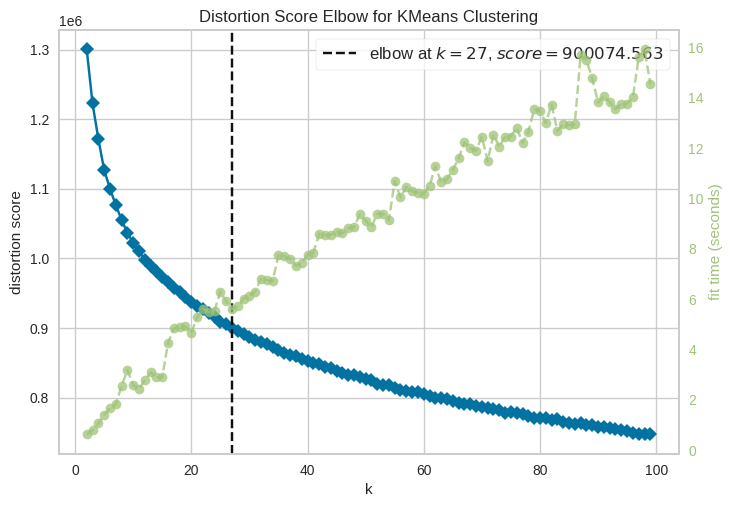

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [13]:
visualizer_100.fit(karta_mat_features)        # Fit the data to the visualizer
visualizer_100.show()        # Finalize and render the figure

In [5]:
# Instantiate the clustering model and visualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2, 200))

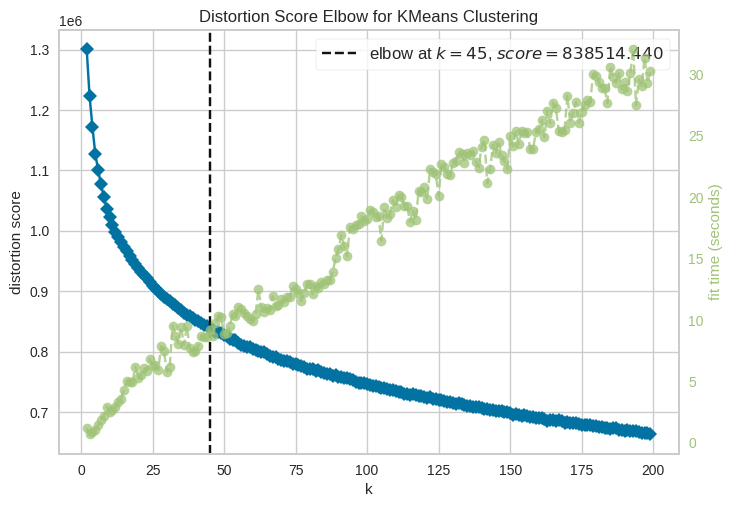

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [6]:
visualizer.fit(karta_mat_features)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

# 6. Silhouette function

In [8]:
import matplotlib.pyplot as plt
from yellowbrick.cluster import SilhouetteVisualizer

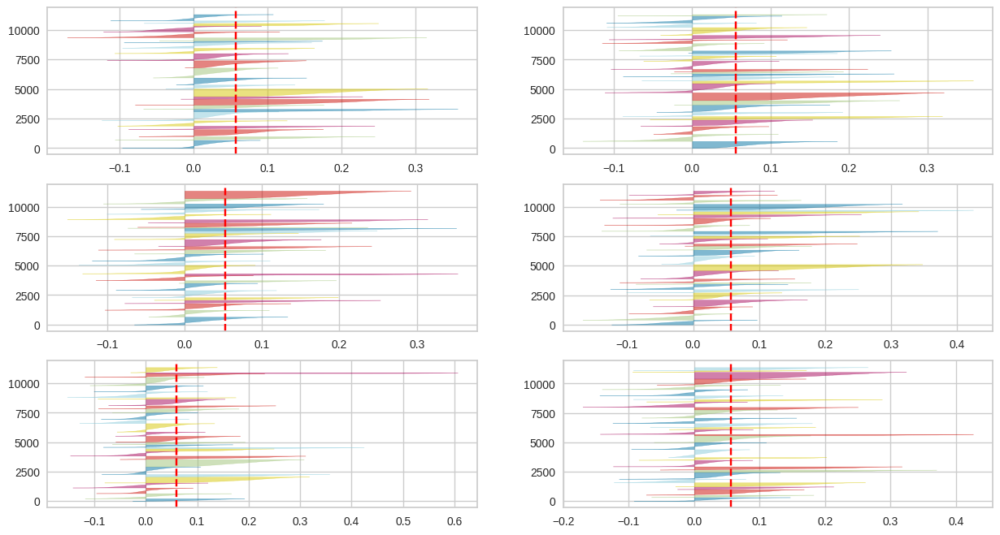

In [9]:
fig, ax = plt.subplots(3, 2, figsize=(15,8))
for i in [25, 26, 27, 28, 29, 30]:
    '''
    Create KMeans instances for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i-23, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(karta_mat_features) 

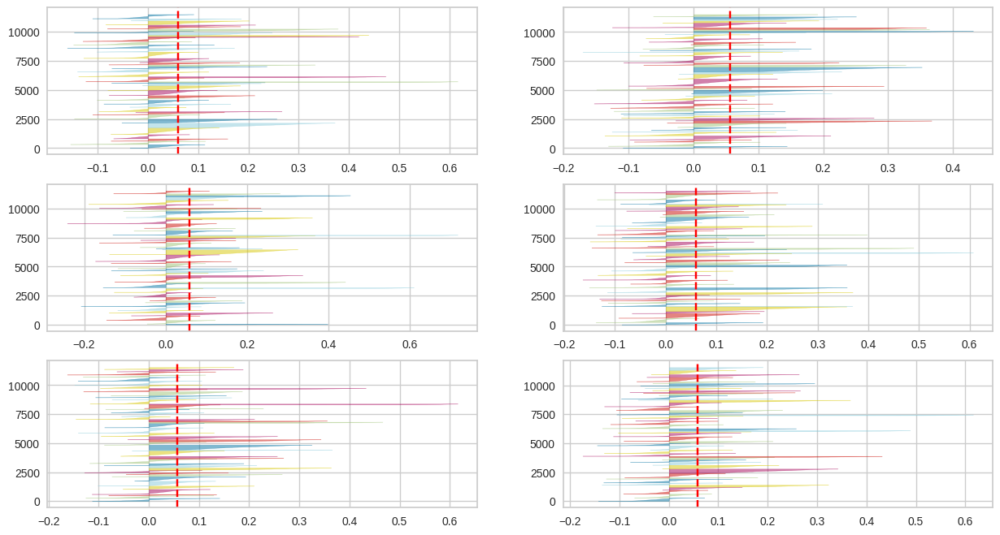

In [11]:
fig, ax = plt.subplots(3, 2, figsize=(15,8))
for i in [43, 44, 45, 46, 47, 48]:
    '''
    Create KMeans instances for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i-41, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(karta_mat_features) 